In [1]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import os, gc
import pickle
import datetime, time
from tqdm import tqdm_notebook as tqdm


from sklearn import preprocessing

%matplotlib inline

In [2]:
path = '/Users/kanoumotoharu/Downloads/m5-forecasting-accuracy/'

In [3]:
os.listdir(path)

['calendar.csv',
 'sell_prices.csv',
 'sales_train_validation.csv',
 'sample_submission.csv']

In [4]:
%%time
train_df = pd.read_csv(path+'sales_train_validation.csv')
calendar_df = pd.read_csv(path+'calendar.csv')
sell_prices_df = pd.read_csv(path+'sell_prices.csv')
sample_submission_df = pd.read_csv(path+'sample_submission.csv')

CPU times: user 12 s, sys: 1.2 s, total: 13.2 s
Wall time: 13.3 s


In [5]:
train_df.head()

,id,item_id,dept_id,cat_id,store_id,state_id,d_1,d_2,d_3,d_4,...,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913
0,HOBBIES_1_001_CA_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,1,3,0,1,1,1,3,0,1,1
1,HOBBIES_1_002_CA_1_validation,HOBBIES_1_002,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
2,HOBBIES_1_003_CA_1_validation,HOBBIES_1_003,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,2,1,2,1,1,1,0,1,1,1
3,HOBBIES_1_004_CA_1_validation,HOBBIES_1_004,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,1,0,5,4,1,0,1,3,7,2
4,HOBBIES_1_005_CA_1_validation,HOBBIES_1_005,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,2,1,1,0,1,1,2,2,2,4


In [6]:
train_df.store_id.nunique()

10

In [7]:
calendar_df.head()

,date,wm_yr_wk,weekday,wday,month,year,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI
0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
1,2011-01-30,11101,Sunday,2,1,2011,d_2,NaN,NaN,NaN,NaN,0,0,0
2,2011-01-31,11101,Monday,3,1,2011,d_3,NaN,NaN,NaN,NaN,0,0,0
3,2011-02-01,11101,Tuesday,4,2,2011,d_4,NaN,NaN,NaN,NaN,1,1,0
4,2011-02-02,11101,Wednesday,5,2,2011,d_5,NaN,NaN,NaN,NaN,1,0,1


In [8]:
sell_prices_df.head()

,store_id,item_id,wm_yr_wk,sell_price
0,CA_1,HOBBIES_1_001,11325,9.58
1,CA_1,HOBBIES_1_001,11326,9.58
2,CA_1,HOBBIES_1_001,11327,8.26
3,CA_1,HOBBIES_1_001,11328,8.26
4,CA_1,HOBBIES_1_001,11329,8.26


In [9]:
d_cols = [f'd_{i}' for i in range(1,1914)]

In [10]:
data = train_df.set_index('id')[d_cols].T
data.reset_index(drop=True, inplace=True)

In [11]:
calendar_df.date = pd.to_datetime(calendar_df.date)

In [12]:
calendar_df2 = calendar_df[:1913]

In [13]:
data = pd.concat([
    calendar_df2[
        ['date', 'wm_yr_wk', 'weekday','event_name_1',
         'event_type_1', 'event_name_2', 'event_type_2',
         'snap_CA', 'snap_TX', 'snap_WI']
    ],
    data
],axis=1)

In [14]:
data.head()

,date,wm_yr_wk,weekday,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI,...,FOODS_3_818_WI_3_validation,FOODS_3_819_WI_3_validation,FOODS_3_820_WI_3_validation,FOODS_3_821_WI_3_validation,FOODS_3_822_WI_3_validation,FOODS_3_823_WI_3_validation,FOODS_3_824_WI_3_validation,FOODS_3_825_WI_3_validation,FOODS_3_826_WI_3_validation,FOODS_3_827_WI_3_validation
0,2011-01-29,11101,Saturday,NaN,NaN,NaN,NaN,0,0,0,...,0,14,1,0,4,0,0,0,0,0
1,2011-01-30,11101,Sunday,NaN,NaN,NaN,NaN,0,0,0,...,0,11,1,0,4,0,0,6,0,0
2,2011-01-31,11101,Monday,NaN,NaN,NaN,NaN,0,0,0,...,0,5,1,0,2,2,0,0,0,0
3,2011-02-01,11101,Tuesday,NaN,NaN,NaN,NaN,1,1,0,...,0,6,1,0,5,2,0,2,0,0
4,2011-02-02,11101,Wednesday,NaN,NaN,NaN,NaN,1,0,1,...,0,5,1,0,2,0,0,2,0,0


In [28]:
sell_prices_df['id'] = sell_prices_df['item_id']+'_'+sell_prices_df['store_id']+'_validation'
sell_prices_df.head()

,store_id,item_id,wm_yr_wk,sell_price,id
0,CA_1,HOBBIES_1_001,11325,9.58,HOBBIES_1_001_CA_1_validation
1,CA_1,HOBBIES_1_001,11326,9.58,HOBBIES_1_001_CA_1_validation
2,CA_1,HOBBIES_1_001,11327,8.26,HOBBIES_1_001_CA_1_validation
3,CA_1,HOBBIES_1_001,11328,8.26,HOBBIES_1_001_CA_1_validation
4,CA_1,HOBBIES_1_001,11329,8.26,HOBBIES_1_001_CA_1_validation


In [18]:
col='FOODS_3_818_WI_3_validation'
tmp_df = data[['date', col]]

In [25]:
tmp_df['wm_yr_wk'] = tmp_df['date'].map(calendar_df.set_index('date')['wm_yr_wk'].to_dict())

In [32]:
d = sell_prices_df[sell_prices_df.id==col].set_index('wm_yr_wk')['sell_price'].to_dict()

In [34]:
tmp_df['sell_price'] = tmp_df['wm_yr_wk'].map(d)

In [39]:
tmp_df['isna'] = tmp_df.sell_price.apply(lambda x: 0 if not np.isnan(x) else x)
tmp_df['sold'] = tmp_df[col]+tmp_df['isna']

In [40]:
tmp_df.head()

,date,FOODS_3_818_WI_3_validation,wm_yr_wk,sell_price,isna,sold
0,2011-01-29,0,11101,NaN,NaN,NaN
1,2011-01-30,0,11101,NaN,NaN,NaN
2,2011-01-31,0,11101,NaN,NaN,NaN
3,2011-02-01,0,11101,NaN,NaN,NaN
4,2011-02-02,0,11101,NaN,NaN,NaN


In [47]:
def plot(data, col, sell_prices_df):
    tmp_df = data[['date', col]]
    tmp_df['wm_yr_wk'] = tmp_df['date'].map(calendar_df.set_index('date')['wm_yr_wk'].to_dict())
    d = sell_prices_df[sell_prices_df.id==col].set_index('wm_yr_wk')['sell_price'].to_dict()
    tmp_df['sell_price'] = tmp_df['wm_yr_wk'].map(d)
    tmp_df['isna'] = tmp_df.sell_price.apply(lambda x: 0 if not np.isnan(x) else x)
    tmp_df['sold'] = tmp_df[col]+tmp_df['isna']
    
    plt.figure(figsize=(30,7))
    plt.plot(tmp_df.date, tmp_df[col], label='Row_data', alpha=0.4)
    plt.plot(tmp_df[tmp_df.sold.notna()]['date'], tmp_df[tmp_df.sold.notna()][col], alpha=0.4)
    plt.legend()
    plt.show()

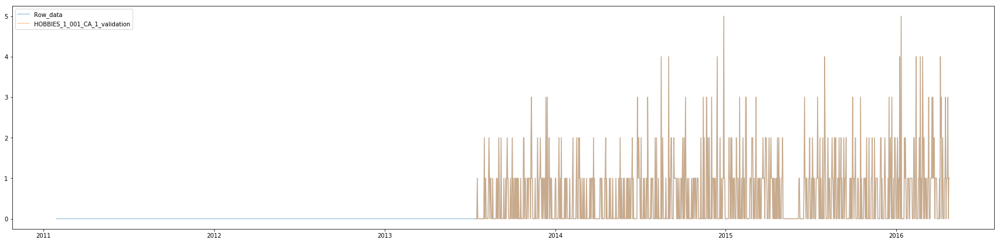

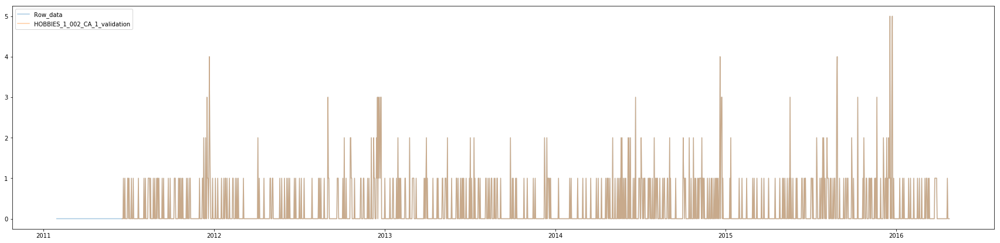

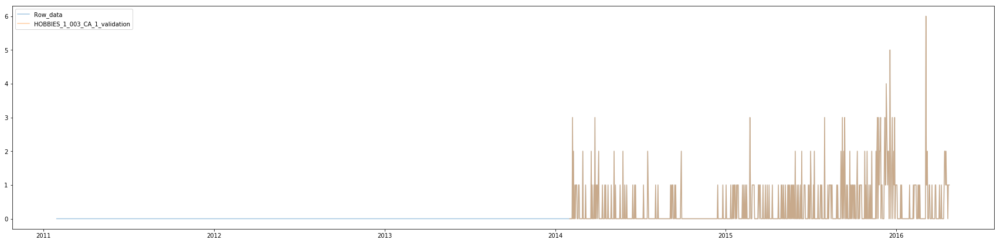

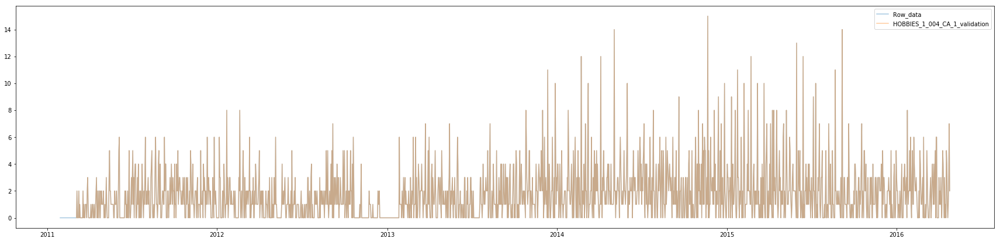

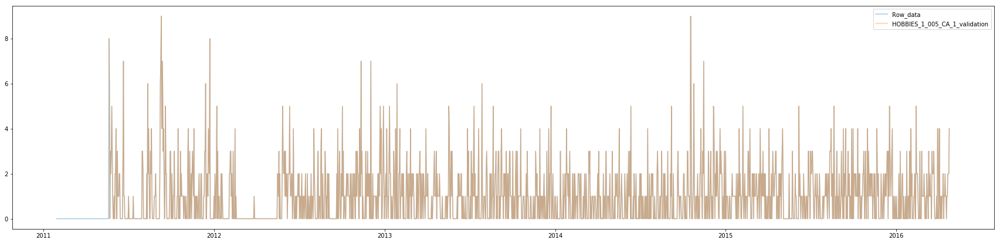

...

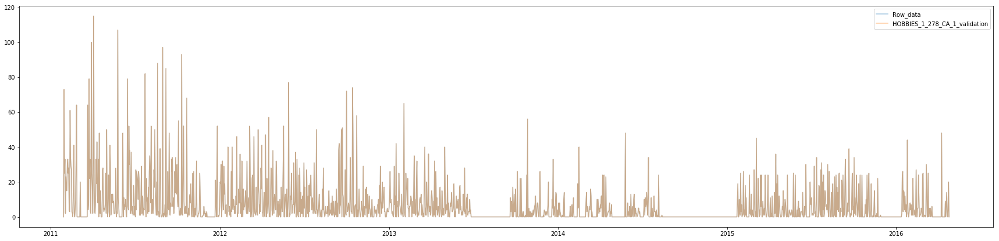

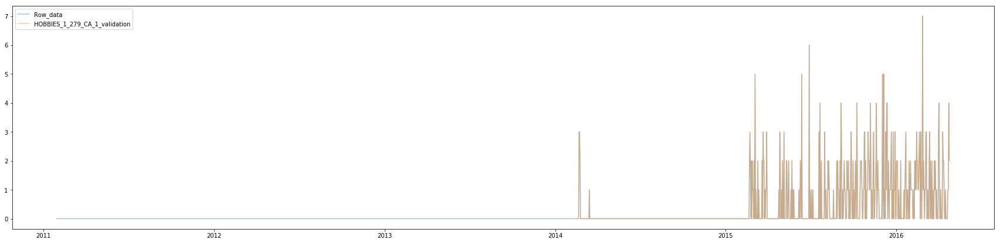

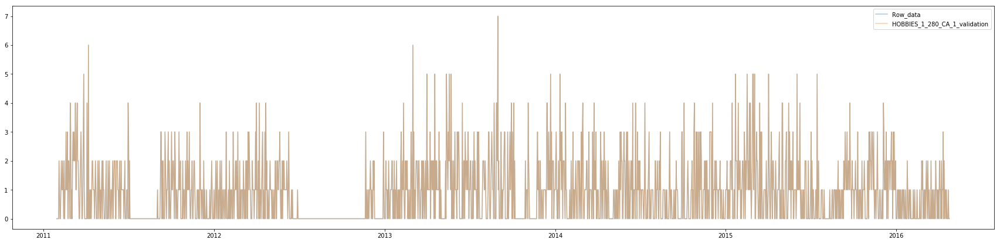

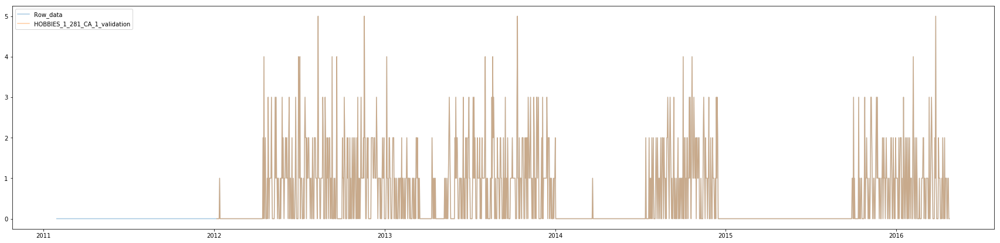

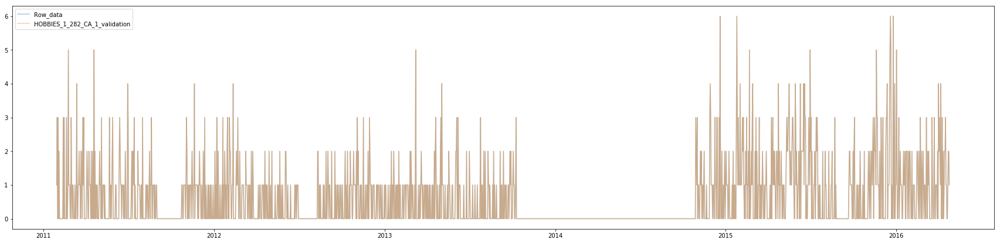

KeyboardInterrupt: 

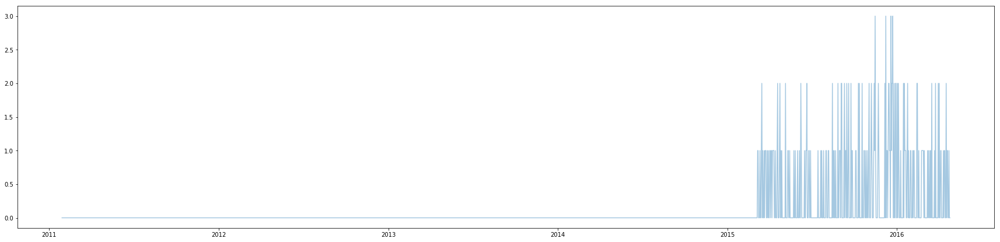

In [51]:
for col in train_df.id.unique():
    plot(data, col, sell_prices_df)

In [69]:
for col in tqdm(train_df.id.unique()):
    if (set(sell_prices_df[sell_prices_df.id==col].wm_yr_wk.unique())&set(calendar_df[1913-100:1913].wm_yr_wk.unique()))\
                                                                                                                ==calendar_df[1913-200:1913].wm_yr_wk.nunique():
        print(col)

KeyboardInterrupt: 

In [140]:
a = sell_prices_df.groupby(['id'])['wm_yr_wk'].unique()

売ったものは売るのをやめることはない

In [163]:
l=[]
for col, v in tqdm(a.iteritems(), ):
    if  v[:-8].tolist()==np.sort(calendar_df[:1913].wm_yr_wk.unique()[-len(v[:-8]):]).tolist():
        l.append(col)